In [1]:
%matplotlib inline

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

sns.set_style('white')
sns.set_context("poster")

col=['timestamp', 'sensor_id', 'loc_dir', 'loc_pin', 'loc_spn', 'loc_pot', 'val']
df = pd.read_hdf('data1-zdc.h5', 'table', where='sensor_type in str', mode='r', columns=col)
df.head()

# df = pd.read_hdf(file_path,
#                      'table',
#                      where='sensor_type in tmp',
#                      columns=['timestamp', 'sensor_id', 'loc_dir', 'loc_spn', 'val', 'remark'])

,timestamp,sensor_id,loc_dir,loc_pin,loc_spn,loc_pot,val
6,2017-07-01,144,SW,top,SS,outer,3368.0420
8,2017-07-01,143,SW,top,SS,outer,3596.3900
10,2017-07-01,142,SW,top,SS,outer,6740.7440
11,2017-07-01,173,SE,top,MS,inner,158.5201
12,2017-07-01,141,SW,top,SS,outer,6785.4340


In [2]:
df.dtypes

timestamp    datetime64[ns]
sensor_id             int64
loc_dir            category
loc_pin            category
loc_spn            category
loc_pot            category
val                 float64
dtype: object

In [6]:
dates = pd.DatetimeIndex(df.timestamp)
month = dates.month.unique()[0]
print(month)

7


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 580622 entries, 6 to 999998
Data columns (total 7 columns):
timestamp    580622 non-null datetime64[ns]
sensor_id    580622 non-null int64
loc_dir      580622 non-null category
loc_pin      516098 non-null category
loc_spn      580622 non-null category
loc_pot      559114 non-null category
val          580622 non-null float64
dtypes: category(4), datetime64[ns](1), float64(1), int64(1)
memory usage: 19.9 MB


In [8]:
# df.sensor_id.unique()

In [9]:
# pivot table to time vs sensor_id

df_piv = pd.pivot_table(df, values='val', index=['timestamp'], columns=['sensor_id'])
df_piv.describe()

# can compare the mean and std

sensor_id,60,61,62,63,64,65,66,67,68,69,...,2221,2222,2223,2224,2225,2226,2227,2228,2229,2230
count,5377.000000,5377.000000,5377.000000,5377.000000,5375.000000,5375.000000,5375.000000,5375.000000,5377.000000,5377.000000,...,5377.000000,5377.000000,5377.000000,5377.000000,5377.000000,5377.000000,5377.000000,5377.000000,5377.000000,5377.000000
mean,1132.361080,971.077024,791.362690,1143.067661,-112.363281,-582.700563,-3411.548573,-3371.756389,1047.675051,1219.900882,...,544.405997,770.913634,380.611833,228.616699,671.296366,1192.779534,380.947170,1555.223831,680.066874,974.840992
std,14.276801,13.443144,8.958797,9.020206,40.072391,39.401568,40.410534,38.635889,6.670517,6.502247,...,10.272474,9.420186,3.315183,14.146895,5.304961,17.624944,5.681733,6.396554,4.799867,6.435282
min,1061.820000,927.926500,757.873200,1111.862000,-227.407600,-771.736300,-3591.749400,-3505.775000,1022.764000,1206.075000,...,461.400000,715.964100,374.111300,191.172900,661.152400,1154.037000,353.513600,1533.349000,655.558500,954.788700
25%,1126.677000,964.579600,787.695300,1137.782000,-138.858050,-597.905050,-3428.368950,-3395.392000,1044.298000,1215.299000,...,540.783300,766.447100,377.757500,215.178500,666.411700,1175.591000,376.395400,1549.938000,676.757400,969.426500
50%,1135.408000,970.005100,791.183000,1141.908000,-119.250300,-575.601500,-3407.303500,-3375.976000,1047.476000,1218.837000,...,544.061500,769.599000,380.525700,228.963100,671.418900,1193.119000,381.178700,1554.856000,680.218200,974.342500
75%,1139.518000,976.265700,796.195100,1146.793000,-96.551550,-556.391850,-3386.995600,-3355.857500,1050.756000,1222.387000,...,549.167100,775.517500,382.722800,241.546600,676.031200,1209.127000,385.862900,1560.292000,684.035100,979.883600
max,1170.503000,1041.594000,835.937100,1183.625000,78.332700,-469.682000,-3269.750500,-3198.307000,1093.870000,1273.214000,...,579.897500,806.626300,402.545400,253.526700,684.541800,1223.909000,391.576600,1570.409000,692.474100,991.026900


C:\Users\brian1123\Anaconda3\lib\site-packages\matplotlib\pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


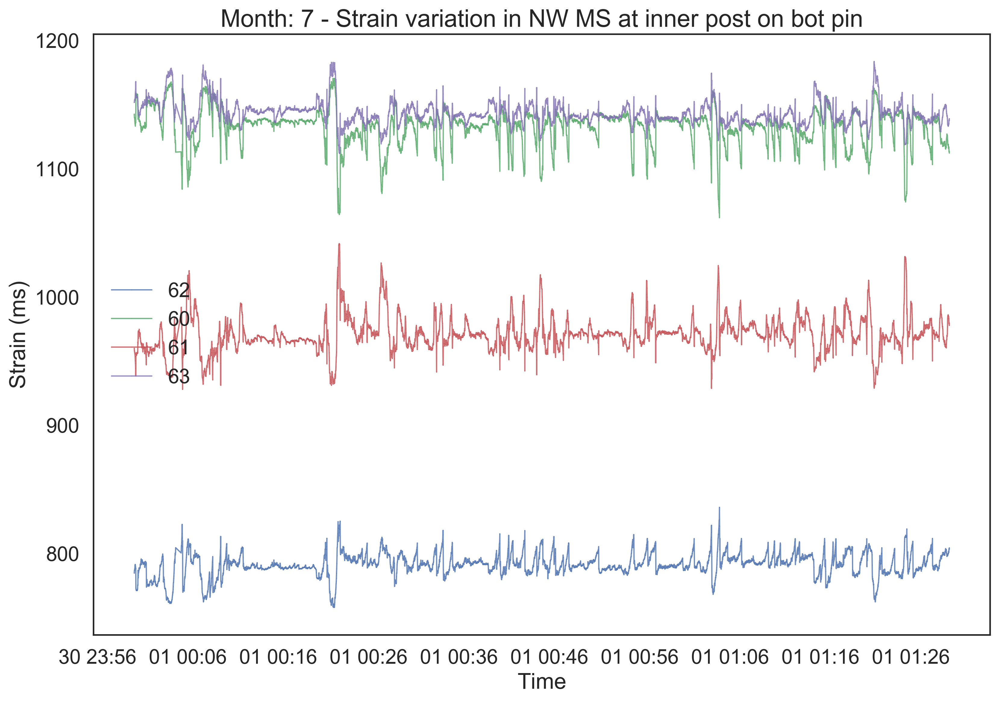

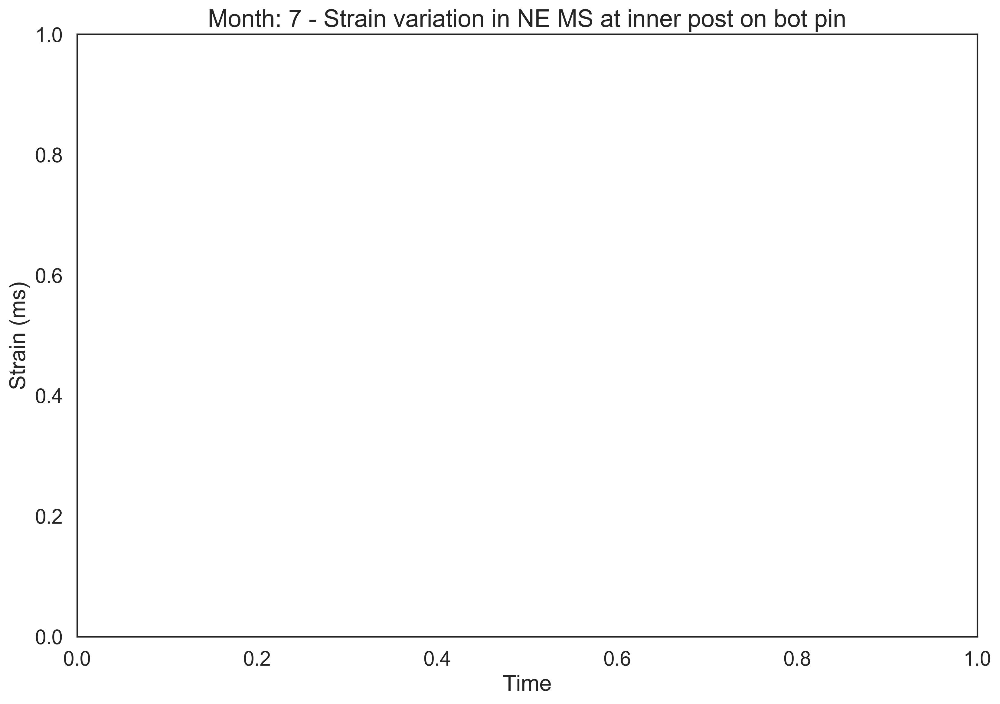

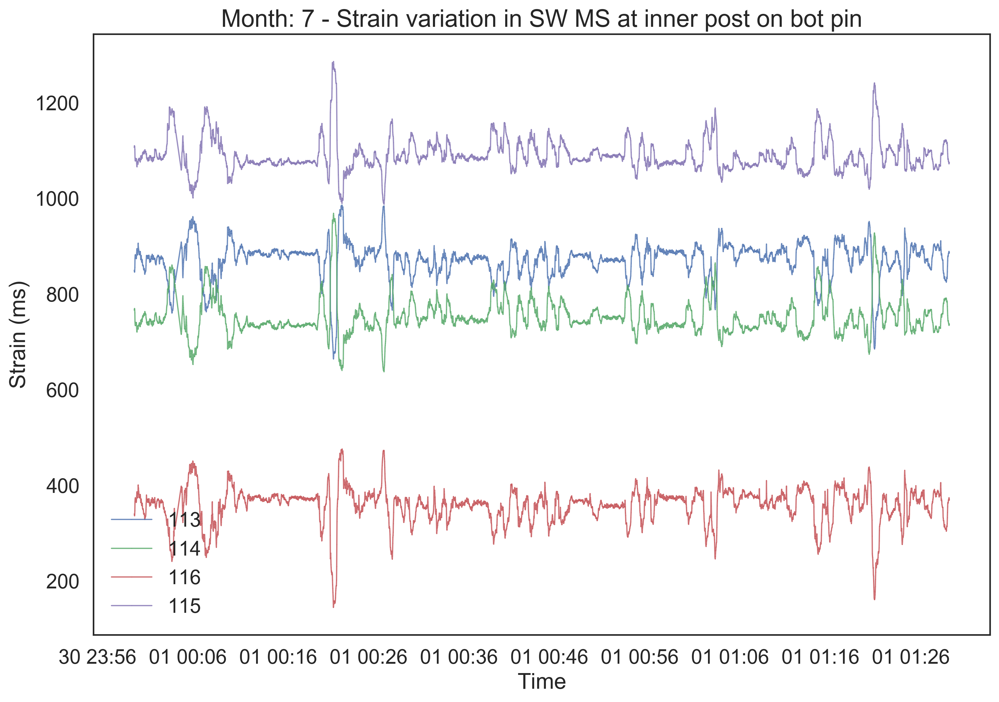

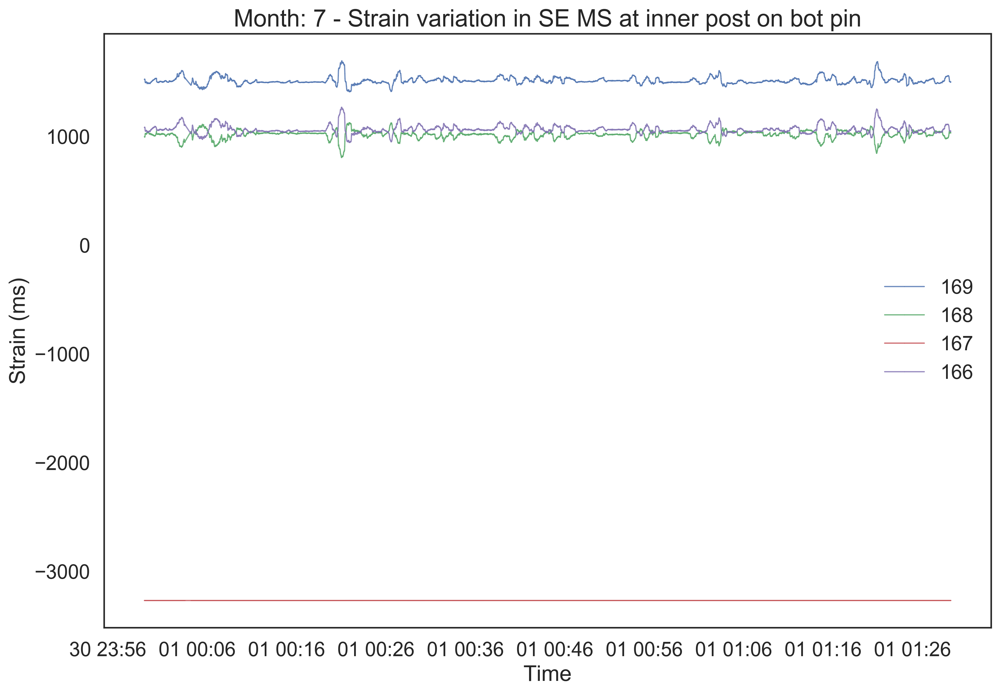

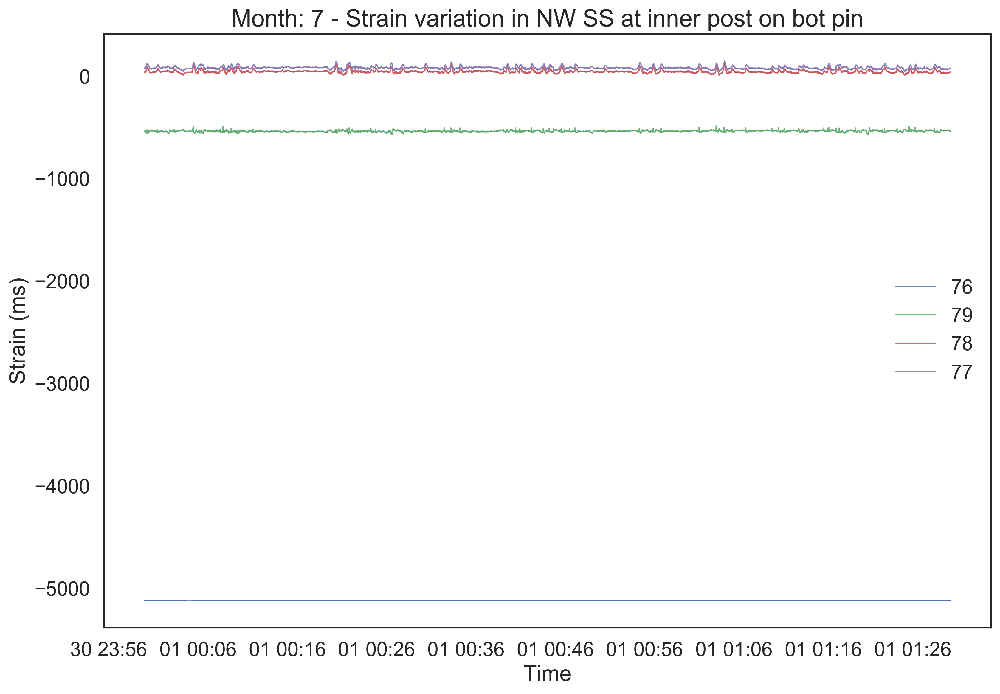

...

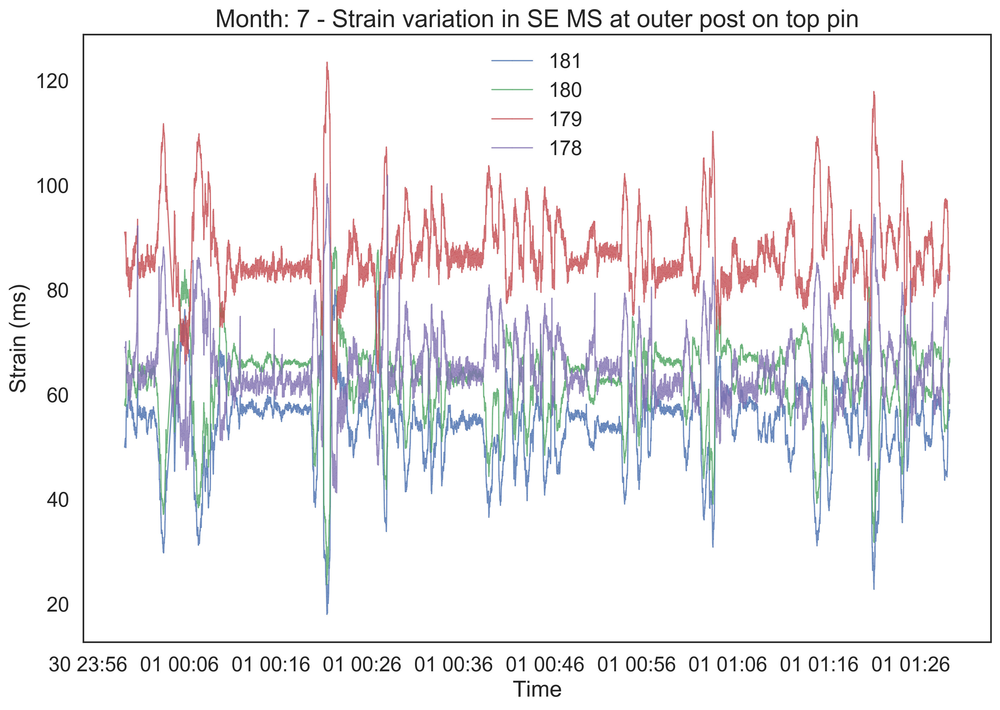

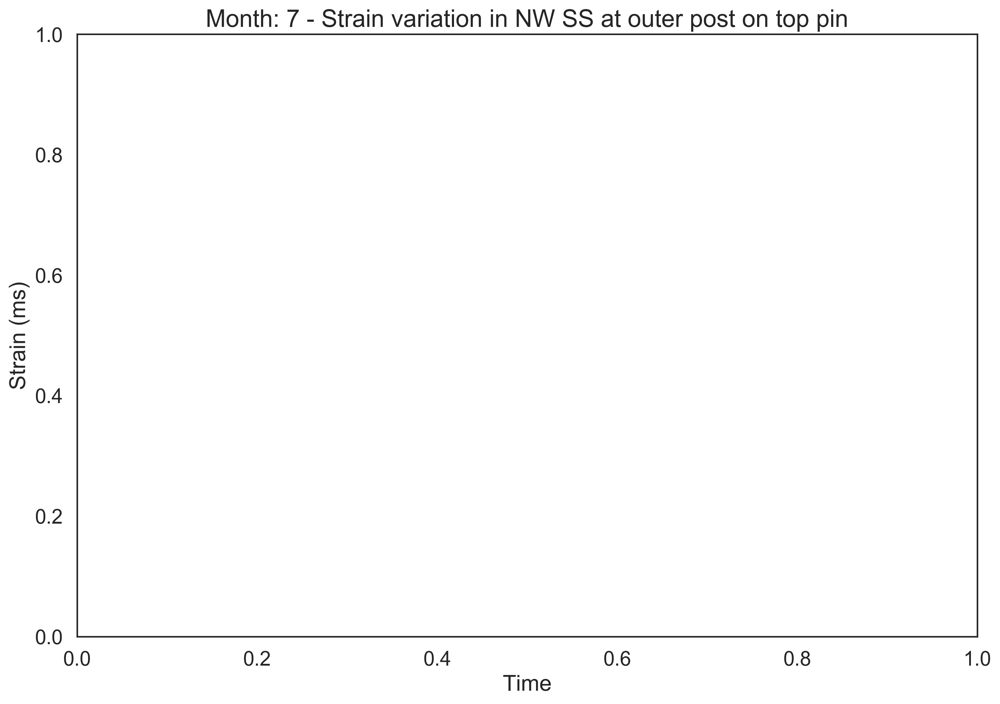

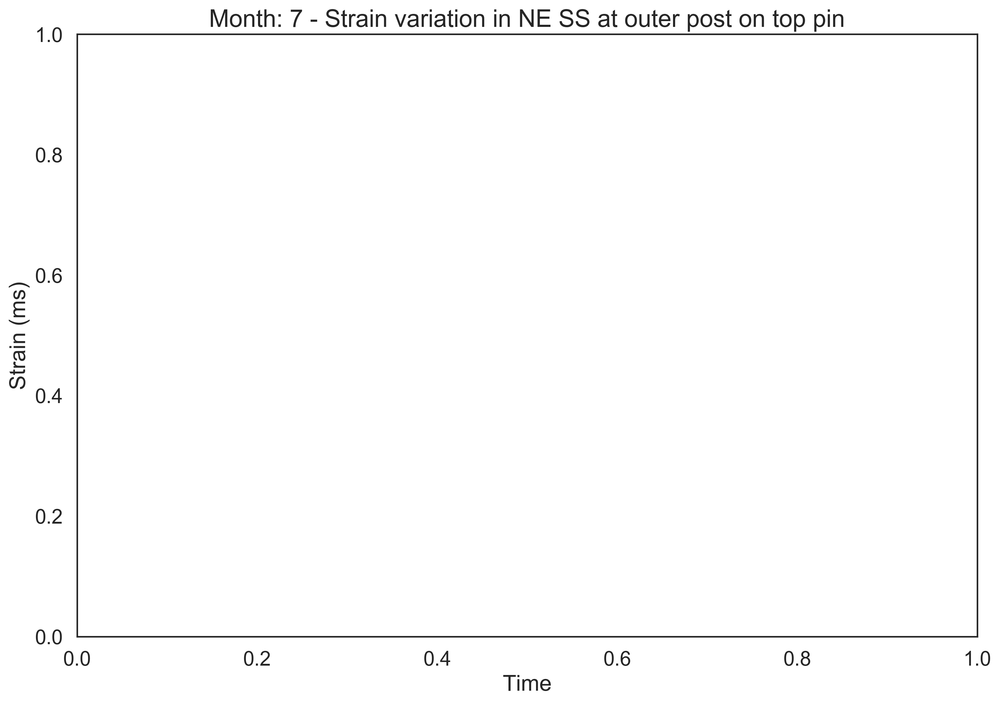

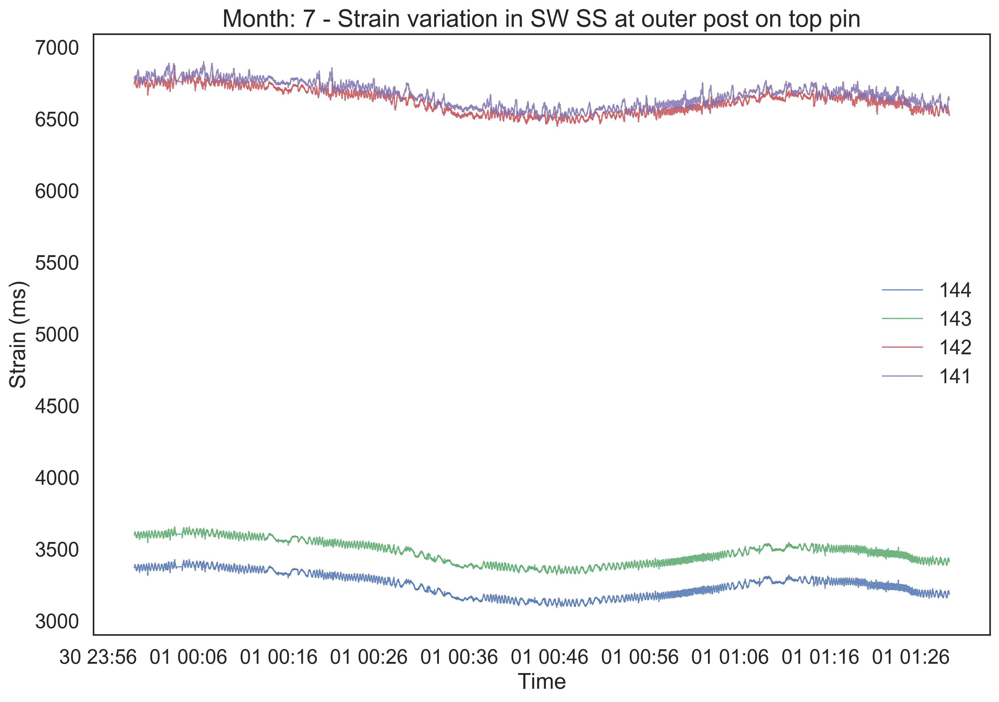

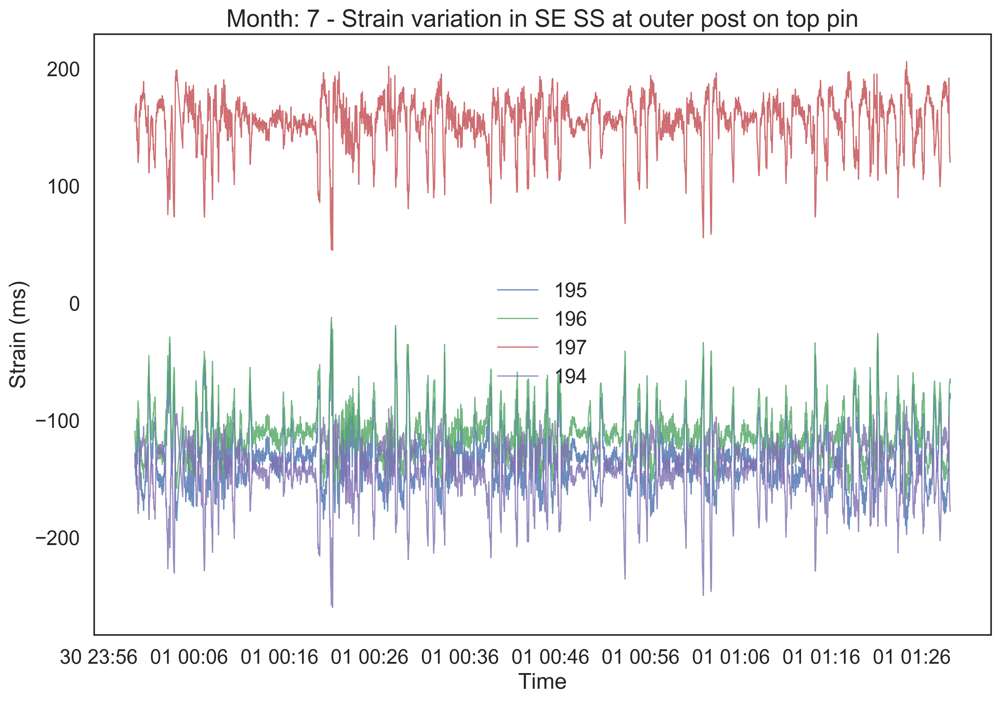

In [11]:
# plot

directions = ['NW', 'NE', 'SW', 'SE']
spans = ['MS', 'SS']
pots = ['inner', 'outer']
pins = ['bot', 'top']

for pin in pins:
    for pot in pots:
        for span in spans:
            for direction in directions:
                df_str = (df[(df['loc_dir'] == direction)
                             & (df['loc_spn'] == span)
                             & (df['loc_pot'] == pot)
                             & (df['loc_pin'] == pin)])

                fig = plt.figure(dpi=300)
                ax = fig.add_subplot(111)

                for sensor in df_str.sensor_id.unique():
                    x = df_str[df_str['sensor_id'] == sensor].timestamp
                    y = df_str[df_str['sensor_id'] == sensor].val

                    ax.plot_date(x, y, alpha=0.8, linewidth=1, label=sensor, linestyle='-', marker='.', markersize=1)
                    ax.legend()

                title = 'Month: ' + str(month) + ' - Strain variation in ' + direction + ' ' + span + ' at ' + pot + ' post on ' + pin + ' pin'
                plt.title(title)
                plt.xlabel('Time')
                plt.ylabel('Strain (ms)')
#                 plt.ylim(-20, 40)
#                 fig.savefig('fig-' + title.replace(' ', '-') + '.png')

In [8]:
# find correltion of sensors
# try with NWMS-*-STR-*, bottom pin

from scipy import stats

In [38]:
# find correltion of sensors
# try with NWMS-*-STR-*, bottom pin

df_corr = (df[(df['loc_dir'] == 'NW')
             & (df['loc_spn'] == 'MS')
             & (df['loc_pot'] == 'inner')
             & (df['loc_pin'] == 'bot')])
df_corr.head()
df_corr.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21508 entries, 187 to 999952
Data columns (total 7 columns):
timestamp    21508 non-null datetime64[ns]
sensor_id    21508 non-null int64
loc_dir      21508 non-null category
loc_pin      21508 non-null category
loc_spn      21508 non-null category
loc_pot      21508 non-null category
val          21508 non-null float64
dtypes: category(4), datetime64[ns](1), float64(1), int64(1)
memory usage: 756.6 KB


In [39]:
# Y and Z are numpy arrays or lists of variables 
# stats.pearsonr(Y, Z)
df_corr = pd.pivot_table(df_corr, values='val', index=['timestamp'], columns=['sensor_id'])
print(df_corr.head())
print(df_corr.corr())

sensor_id                  60        61        62        63
timestamp                                                  
2017-07-01 00:00:05  1142.564  959.9317  784.6052  1151.656
2017-07-01 00:00:06  1139.836  958.2463  786.5867  1152.222
2017-07-01 00:00:07  1139.981  957.2980  787.0498  1153.632
2017-07-01 00:00:08  1139.071  956.3732  787.6066  1153.907
2017-07-01 00:00:09  1136.889  956.0677  788.5237  1153.433
sensor_id        60        61        62        63
sensor_id                                        
60         1.000000 -0.781671 -0.951328  0.672129
61        -0.781671  1.000000  0.727084 -0.935626
62        -0.951328  0.727084  1.000000 -0.722300
63         0.672129 -0.935626 -0.722300  1.000000


In [40]:
df_corr = (df[(df['loc_dir'] == 'NW')
             & (df['loc_spn'] == 'MS')
             & (df['loc_pot'] == 'inner')])
df_corr = pd.pivot_table(df_corr, values='val', index=['timestamp'], columns=['sensor_id'])
df_corr.corr()

sensor_id,60,61,62,63,64,65,66,67
sensor_id,,,,,,,,
60,1.000000,-0.781671,-0.951328,0.672129,0.780815,-0.779821,-0.844601,0.821479
61,-0.781671,1.000000,0.727084,-0.935626,-0.858582,0.853521,0.890617,-0.901685
62,-0.951328,0.727084,1.000000,-0.722300,-0.874467,0.876405,0.906770,-0.884365
63,0.672129,-0.935626,-0.722300,1.000000,0.942060,-0.938625,-0.932533,0.949938
64,0.780815,-0.858582,-0.874467,0.942060,1.000000,-0.999727,-0.992609,0.994540
65,-0.779821,0.853521,0.876405,-0.938625,-0.999727,1.000000,0.992037,-0.993656
66,-0.844601,0.890617,0.906770,-0.932533,-0.992609,0.992037,1.000000,-0.998478
67,0.821479,-0.901685,-0.884365,0.949938,0.994540,-0.993656,-0.998478,1.000000


In [42]:
# corr

directions = ['NW', 'NE', 'SW', 'SE']
spans = ['MS', 'SS']
pots = ['inner', 'outer']
pins = ['bot', 'top']

for pin in pins:
    for pot in pots:
        for span in spans:
            for direction in directions:
                df_corr = (df[(df['loc_dir'] == direction)
                             & (df['loc_spn'] == span)
                             & (df['loc_pot'] == pot)
                             & (df['loc_pin'] == pin)])
                df_corr = pd.pivot_table(df_corr, values='val', index=['timestamp'], columns=['sensor_id'])
                print('Sensor Group Correlation: ' + direction + ' ' + span + ' at ' + pot + ' post on ' + pin + ' pin')
                print(df_corr.corr())

Sensor Group Correlation: NW MS at inner post on bot pin
sensor_id        60        61        62        63
sensor_id                                        
60         1.000000 -0.781671 -0.951328  0.672129
61        -0.781671  1.000000  0.727084 -0.935626
62        -0.951328  0.727084  1.000000 -0.722300
63         0.672129 -0.935626 -0.722300  1.000000
Sensor Group Correlation: NE MS at inner post on bot pin
Empty DataFrame
Columns: []
Index: []
Sensor Group Correlation: SW MS at inner post on bot pin
sensor_id       113       114       115       116
sensor_id                                        
113        1.000000 -0.985174 -0.979407  0.997117
114       -0.985174  1.000000  0.997664 -0.978876
115       -0.979407  0.997664  1.000000 -0.968152
116        0.997117 -0.978876 -0.968152  1.000000
Sensor Group Correlation: SE MS at inner post on bot pin
sensor_id       166       167       168       169
sensor_id                                        
166        1.000000 -0.141666 -0.9

Sensor Group Correlation: SW SS at outer post on top pin
sensor_id       141       142       143       144
sensor_id                                        
141        1.000000  0.934522  0.969144  0.969144
142        0.934522  1.000000  0.988029  0.988029
143        0.969144  0.988029  1.000000  1.000000
144        0.969144  0.988029  1.000000  1.000000
Sensor Group Correlation: SE SS at outer post on top pin
sensor_id       194       195       196       197
sensor_id                                        
194        1.000000 -0.911534 -0.927750  0.999165
195       -0.911534  1.000000  0.998820 -0.926034
196       -0.927750  0.998820  1.000000 -0.940549
197        0.999165 -0.926034 -0.940549  1.000000


In [ ]:
print('DONE')